<a href="https://colab.research.google.com/github/jkcg-learning/SuperGradients/blob/main/SG_transfer_learning_object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

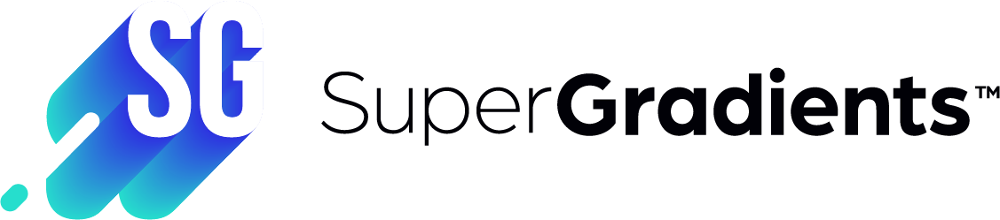

# Object Detection Transfer Learning with SuperGradients

In the following tutorial, we will demonstrate how to use one of SuperGradients pre-trained models and a custom dataset to improve the model's
accuracy using transfer learning for object detection.

Transfer Learning from a pre-trained checkpoint on your own dataset could prove to be very effective instead of deploying the pre-trained model directly on your data or training a model from scratch.
For more information on Transfer Learning, please visit: https://cs231n.github.io/transfer-learning/

In the following example, transfer learning will be used from a COCO2017-pretrained YoloV5Nano model to a custom dataset - a subset of the Pascal VOC 2012 and Pascal VOC 2007 datasets which only has "person" class images and labels.
This Dataset will be named "Person Detection Dataset" just for the example.
Using SuperGradients's dataset sub-classing feature will allow you to generate a partial sub-dataset that has only images and labels covering the desired class(es)

An example real-world use-case of the afformentioned scenario is a surveillance system that detects people.


The tutorial will be comprised of the following steps: 

1.   Generating a sub-dataset of the Pascal VOC 2007 and Pascal VOC 2012 datsets for transfer learning.
2.   Creating new anchors that are a better fit for this new dataset.
3.   Loading SuperGradients' pretrained YoloV5nano and adjust its architecture for the new task replacing its anchors and its last detecting layers according to the new number of classes (single "person" class).
4.   Defining training parameters.
5.   Training the model.
6.   Reviewing the ~5% improvement in Average Precision (AP @ 0.5:0.95) over the pre-trained checkpoint. 





First, let's install the latest version of super-gradients:

In [ ]:
! pip install super_gradients gwpy &> /dev/null
! pip install matplotlib==3.1.3 gwpy &> /dev/null

Imports:

In [ ]:
import os

import super_gradients
from super_gradients.training import SgModel
from super_gradients.training.datasets.dataset_interfaces.dataset_interface import PascalVOCUnifiedDetectionDataSetInterface
from super_gradients.training.metrics.detection_metrics import DetectionMetrics
from super_gradients.training.utils.detection_utils import base_detection_collate_fn, Anchors, AnchorGenerator
from super_gradients.training.utils.callbacks import Phase, DetectionVisualizationCallback
from super_gradients.training.models.detection_models.yolov5 import YoloV5PostPredictionCallback

You did not mention an AWS environment.You can set the environment variable ENVIRONMENT_NAME with one of the values: development,staging,production
callbacks -WARNING- Failed to import deci_lab_client


# Generating the sub-classed Person Dataset

"Person Detection Dataset" is actually created using the "class_inclusion_list" parameter which will create a sub-dataset that contains only the images and labels for the classes that are inside the list.

*Feel free to change the sub_classes_list variable and add/change the classes you are interested in to use transfer learning
 on the pre-trained checkpoint.
Please make sure that you are only using a subset of the 20 classes of Pascal VOC detection available here: 
http://host.robots.ox.ac.uk/pascal/VOC/voc2012/#devkit

Let's start with downloading the data and initializing a dataset interface that will be used for the pre-trained model evaluation (you only need
to instantiate PascalVOCUnifiedDetectionDataSetInterface with parameter "download": True in the dataset_params dict,
for the dataset to be downloaded):

In [ ]:
sub_classes_list = ['person']

In [ ]:
sub_dataset_params = {"batch_size": 48,
                  "val_batch_size": 48,
                  "train_image_size": 512,
                  "val_image_size": 512,
                  "val_collate_fn": base_detection_collate_fn,
                  "train_collate_fn": base_detection_collate_fn,
                  "train_sample_loading_method": "mosaic",
                  "val_sample_loading_method": "default",
                  "dataset_hyper_param": {
                      "hsv_h": 0.015,  # IMAGE HSV-Hue AUGMENTATION (fraction)
                      "hsv_s": 0.7,  # IMAGE HSV-Saturation AUGMENTATION (fraction)
                      "hsv_v": 0.4,  # IMAGE HSV-Value AUGMENTATION (fraction)
                      "degrees": 0.0,  # IMAGE ROTATION (+/- deg)
                      "translate": 0.1,  # IMAGE TRANSLATION (+/- fraction)
                      "scale": 0.5,  # IMAGE SCALE (+/- gain)
                      "shear": 0.0},  # IMAGE SHEAR (+/- deg)
                  "class_inclusion_list": sub_classes_list,
                  "download": True,
                  "data_root": "/home/data/pascal_unified_coco_format/"
                  }

In [ ]:
# PascalVOCUnifiedDetectionDataSetInterface - a unified DataSetInterface that combines
# images and labels from PASCAL VOC 2007, and PASCAL VOC 2012

# We use cache_labels=True to pre-load the dataset labels to reduce I/O overhead on small files and improve performance  

trainer = SgModel(experiment_name="yolov5n_pascal_transfer_learning", ckpt_root_dir="/home/data/notebook_ckpts/")
dataset_interface = PascalVOCUnifiedDetectionDataSetInterface(dataset_params=sub_dataset_params, cache_labels=True)

  0%|          | 0.00/425M [00:00<?, ?B/s]

Unzipping /home/data/pascal_unified_coco_format/images/VOCtrainval_06-Nov-2007.zip...


  0%|          | 0.00/418M [00:00<?, ?B/s]

Unzipping /home/data/pascal_unified_coco_format/images/VOCtest_06-Nov-2007.zip...


  0%|          | 0.00/1.82G [00:00<?, ?B/s]

Unzipping /home/data/pascal_unified_coco_format/images/VOCtrainval_11-May-2012.zip...


test2007: 100%|██████████| 4952/4952 [00:03<00:00, 1607.24it/s]
Caching labels (1025 found, 1476 missing, 0 duplicate, for 2501 images): 100%|██████████| 2501/2501 [00:00<00:00, 7037.30it/s]
Caching labels (1994 found, 3723 missing, 0 duplicate, for 5717 images): 100%|██████████| 5717/5717 [00:00<00:00, 7625.40it/s]
Caching labels (983 found, 1527 missing, 0 duplicate, for 2510 images): 100%|██████████| 2510/2510 [00:00<00:00, 7482.19it/s]
Caching labels (2093 found, 3724 missing, 0 duplicate, for 5823 images): 100%|██████████| 5823/5823 [00:00<00:00, 7921.70it/s]
Caching labels (2007 found, 2944 missing, 0 duplicate, for 4952 images): 100%|██████████| 4952/4952 [00:00<00:00, 8084.01it/s]


In [ ]:
trainer.connect_dataset_interface(dataset_interface, data_loader_num_workers=8)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


# Evaluating pre-trained model performance on Person dataset

In [ ]:
# The pretrained_weights argument will load a pre_trained architecture on the provided dataset
trainer.build_model(architecture="yolo_v5n", arch_params={"pretrained_weights": "coco", "num_classes": 80})

Downloading: "https://deci-pretrained-models.s3.amazonaws.com/YOLOv5+n/ckpt_best.pth" to /root/.cache/torch/hub/checkpoints/YOLOv5+n_ckpt_best.pth


  0%|          | 0.00/21.8M [00:00<?, ?B/s]

In [ ]:
test_metrics_list = [DetectionMetrics(post_prediction_callback=YoloV5PostPredictionCallback(), num_cls=1)]

original_model_validation_results = trainer.test(test_loader=trainer.valid_loader, test_metrics_list=test_metrics_list, metrics_progress_verbose=True)
original_model_ap = original_model_validation_results[2]
print('Original Model\'s AP@0.5:0.95 is ' + f'{100*original_model_ap:.2f}')

Test:   0%|          | 0/42 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Test: 100%|██████████| 42/42 [00:44<00:00,  1.07s/it, F1=0.863, Precision=0.413, Recall=0.923, mAP@0.50:0.95=0.525]

Original Model's AP@0.5:0.95 is 52.46


# Generating new anchors

Training with relevant anchors is crucial in order to fit our new dataset properly 
and since our pre-trained model has been trained with anchors relevant for the COCO2017 dataset, new anchors need to be generated for our new dataset.
(If you are not familiar with the concept of anchor boxes, for more information see https://blog.roboflow.com/what-is-an-anchor-box/).

*We are using a different DataSetInterface for anchors generation even though we are using the same images and labels since the parameters for the Anchors generation process are different from the ones for training/validation 


In [ ]:
dataset_params_anchors = {"batch_size": 1,
                          "val_batch_size": 1,
                          "train_image_size": 512,
                          "val_image_size": 512,
                          "train_sample_loading_method": "default",
                          "class_inclusion_list": sub_classes_list,
                          "download": False,
                          "data_root": "/home/data/pascal_unified_coco_format/"
                          }
anchors_generation_dataset_interface = PascalVOCUnifiedDetectionDataSetInterface(dataset_params=dataset_params_anchors, cache_labels=True)

Caching labels (1025 found, 1476 missing, 0 duplicate, for 2501 images): 100%|██████████| 2501/2501 [00:00<00:00, 4388.48it/s]
Caching labels (1994 found, 3723 missing, 0 duplicate, for 5717 images): 100%|██████████| 5717/5717 [00:01<00:00, 4390.64it/s]
Caching labels (983 found, 1527 missing, 0 duplicate, for 2510 images): 100%|██████████| 2510/2510 [00:00<00:00, 4192.87it/s]
Caching labels (2093 found, 3724 missing, 0 duplicate, for 5823 images): 100%|██████████| 5823/5823 [00:01<00:00, 4443.58it/s]


[Errno 2] No such file or directory: '/home/data/pascal_unified_coco_format/images/VOCdevkit/VOC2007/ImageSets/Main/test.shapes'


Reading image shapes: 100%|██████████| 4952/4952 [00:02<00:00, 2098.82it/s]
Caching labels (2007 found, 2945 missing, 0 duplicate, for 4952 images): 100%|██████████| 4952/4952 [00:01<00:00, 4437.55it/s]


Moving on to generating the anchors: we run K-means in order to cluster the bounding boxes of our training set  (clusters are plotted in the output cell below).

Reading image shapes: 100%|██████████| 6095/6095 [00:06<00:00, 887.83it/s] 

detection_utils -INFO- Running kmeans for 9 anchors on 13256 points...


detection_utils -INFO- Initial results
detection_utils -INFO- thr=0.34: 0.9941 best possible recall, 4.93 anchors past thr
detection_utils -INFO- num_anchors=9, img_size=512
detection_utils -INFO-  metric_all=0.404/0.770-mean/best, past_thr=0.578-mean: 
29,51,  54,104,  94,157,  99,244,  184,218,  158,338,  271,296,  280,440,  428,338


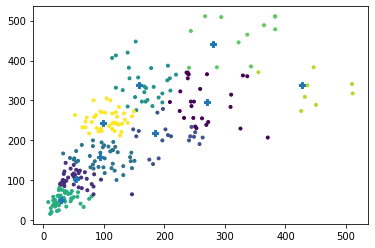

Anchors Generator: Evolving anchors with Genetic Algorithm: fitness = 0.7844: 100%|██████████| 1000/1000 [00:11<00:00, 83.53it/s]

detection_utils -INFO- Final results
detection_utils -INFO- thr=0.34: 0.9978 best possible recall, 4.98 anchors past thr
detection_utils -INFO- num_anchors=9, img_size=512
detection_utils -INFO-  metric_all=0.409/0.785-mean/best, past_thr=0.578-mean: 


22,47,  36,85,  68,119,  79,220,  124,165,  131,284,  207,242,  233,347,  373,355


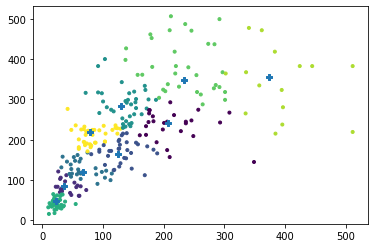

In [ ]:
# AnchorGenerator first uses Kmeans to cluster the relevant bboxes to create anchors.
# after kmeans, this algorithm iteratively makes minor random changes in the anchors 
# and if a change imporves the anchors-data fit it uses the new anchors.

anchor_generator = AnchorGenerator()
anchors = anchor_generator(dataset=anchors_generation_dataset_interface.trainset, thresh=1/2.91)
anchors = Anchors(anchors_list=anchors,
                  strides=[8, 16, 32])

# Preparing our model for transfer learning

This is where the magic happens - SuperGradients automatically replaces the head when loading a pre-trained model that was trained on a different number of classes than the new dataset that it is connected to.
In this example a new head is assembled that will be used to train object detection on a single class (Person class)

*Since the new number of classes in the Person Detection dataset (1 class) is different from the pre-trained model's number of classes
(80 classes) build_model implicitly replaces the detection head automatically to train on the new dataset.
Notice we are also passing our newly generated anchors through 'arch_params'.


In [ ]:
# We move the net to CPU first since we need to re-load it to the GPU only after some CPU-bound initializations.

trainer.net.to('cpu')
trainer.build_model(architecture="yolo_v5n", arch_params={"pretrained_weights": "coco", "anchors": anchors})

# Defining training parameters


In [ ]:
# DEFINE TRAINING PARAMS. SEE DOCS FOR THE FULL LIST.
training_params = {"max_epochs": 50,
                   "lr_mode": "cosine",
                   "initial_lr": 0.0032,
                   "cosine_final_lr_ratio": 0.12,
                   "lr_warmup_epochs": 2,
                   "warmup_bias_lr": 0.05,  # LR TO START FROM DURING WARMUP (DROPS DOWN DURING WARMUP EPOCHS) FOR BIAS.
                   "loss": "yolo_v5_loss",
                   "criterion_params": {"anchors": anchors,
                                        "box_loss_gain": 0.0296, # COEF FOR BOX LOSS COMPONENT
                                        "cls_loss_gain": 0, # COEF FOR CLASSIFICATION
                                        "obj_loss_gain": 0.19264, # OBJECT BCE COEF
                                        "obj_pos_weight": 0.911,  # OBJECT BCE POSITIVE CLASS WEIGHT
                                        "anchor_threshold": 2.91  # RATIO DEFINING THE SIZE RANGE OF AN ANCHOR.
                                        },
                   "optimizer": "SGD",
                   "warmup_momentum": 0.5,
                   "optimizer_params": {"momentum": 0.9,
                                        "weight_decay": 0.0001,
                                        "nesterov": True},
                   "ema": True,
                   "train_metrics_list": [],
                   "valid_metrics_list": [DetectionMetrics(post_prediction_callback=YoloV5PostPredictionCallback(),
                                                           num_cls=len(
                                                               dataset_interface.classes))],
                   "loss_logging_items_names": ["GIoU", "obj", "cls", "Loss"],
                   "metric_to_watch": "mAP@0.50:0.95",
                   "greater_metric_to_watch_is_better": True,
                   "warmup_mode": "yolov5_warmup",
                   "phase_callbacks": [DetectionVisualizationCallback(phase=Phase.VALIDATION_BATCH_END,
                                                                      freq=1,
                                                                      post_prediction_callback=YoloV5PostPredictionCallback(iou=0.45, conf=0.25),
                                                                      classes=dataset_interface.classes,
                                                                      last_img_idx_in_batch=4)]}


# Start training
Make sure to visit the IMAGES tab inside tensorboard once every few epochs to see the predictions improvement on some sample images

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /home/data/notebook_ckpts/ --bind_all

<IPython.core.display.Javascript object>

Finally, call train!

In [ ]:
trainer.train(training_params=training_params)

sg_model -INFO- Using EMA with params {}
sg_model -INFO- Started training for 50 epochs (0/49)



Train epoch 0:   0%|          | 0/127 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/cuda/memory.py:386: FutureWarning: torch.cuda.memory_cached has been renamed to torch.cuda.memory_reserved
  FutureWarning)
Validation epoch 0: 100%|██████████| 42/42 [00:40<00:00,  1.03it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.14888584738861374


Validation epoch 1: 100%|██████████| 42/42 [00:38<00:00,  1.10it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.3268141374054153


Validation epoch 2: 100%|██████████| 42/42 [00:35<00:00,  1.20it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.45677119415189404


Validation epoch 3: 100%|██████████| 42/42 [00:35<00:00,  1.20it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.49167550051851494


Validation epoch 4: 100%|██████████| 42/42 [00:34<00:00,  1.23it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5001019558459767


Validation epoch 5: 100%|██████████| 42/42 [00:35<00:00,  1.20it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5114428739360782


Validation epoch 6: 100%|██████████| 42/42 [00:34<00:00,  1.22it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5186562424354058


Validation epoch 7: 100%|██████████| 42/42 [00:34<00:00,  1.22it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5326109611928393


Validation epoch 8: 100%|██████████| 42/42 [00:34<00:00,  1.23it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5385865033461237


Validation epoch 9: 100%|██████████| 42/42 [00:34<00:00,  1.21it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.541052222229318


Validation epoch 10: 100%|██████████| 42/42 [00:34<00:00,  1.20it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5479930097344854


Validation epoch 11: 100%|██████████| 42/42 [00:34<00:00,  1.22it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.552939515431466


Validation epoch 12: 100%|██████████| 42/42 [00:34<00:00,  1.20it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5546576405098967


Validation epoch 13: 100%|██████████| 42/42 [00:34<00:00,  1.21it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5562609567896037


Validation epoch 14: 100%|██████████| 42/42 [00:34<00:00,  1.21it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5574362014387378


Validation epoch 15: 100%|██████████| 42/42 [00:34<00:00,  1.22it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5590105265662605


Validation epoch 16: 100%|██████████| 42/42 [00:35<00:00,  1.18it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5610964112724688


Validation epoch 17: 100%|██████████| 42/42 [00:34<00:00,  1.23it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5632442143297216


Validation epoch 18: 100%|██████████| 42/42 [00:34<00:00,  1.21it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5644064667899964


Validation epoch 19: 100%|██████████| 42/42 [00:35<00:00,  1.20it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5651170576864728


Validation epoch 20: 100%|██████████| 42/42 [00:35<00:00,  1.20it/s]


base_sg_logger -INFO- Checkpoint saved in /home/data/notebook_ckpts/yolov5n_pascal_transfer_learning/ckpt_best.pth
sg_model -INFO- Best checkpoint overriden: validation mAP@0.50:0.95: 0.5660924769674278


Train epoch 21:  81%|████████  | 103/127 [03:11<00:30,  1.26s/it, GIoU=0.484, Loss=0.022, cls=0, gpu_mem=5.42, obj=0.0397]

# Evaluating the Transfer Learning Model on Person Dataset

In [ ]:
test_metrics_list = [DetectionMetrics(post_prediction_callback=YoloV5PostPredictionCallback(),num_cls=1)]

transfer_learning_model_validation_results = trainer.test(test_loader=trainer.valid_loader, test_metrics_list=test_metrics_list, metrics_progress_verbose=True)

In [ ]:
transfer_learning_model_ap = transfer_learning_model_validation_results[6]
transfer_learning_model_ap

In [ ]:
ap_05_095_score_improvement = transfer_learning_model_ap - original_model_ap
print('You have improved the model\'s AP@0.5:0.95 score by ' + f'{100*ap_05_095_score_improvement:.2f}' + ' percent')

# Summary

This tutorial demonstrated how simple it is to use transfer learning from a pre-trained SuperGradients model to a new dataset.
You can visit our documentation to further learn how to integrate your own Dataset to truly benefit from the principles shown in this tutorial:
https://deci-ai.github.io/super-gradients/